In [71]:
import pandas as pd
import numpy as np
import datetime
import time
import sys
import os
import warnings
warnings.filterwarnings("ignore")

from typing import List, Optional

from entsoe import EntsoePandasClient
from entsoe.exceptions import NoMatchingDataError

import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.io as pio
import plotly.graph_objects as go
from plotly.subplots import make_subplots

from xgboost import XGBRegressor
from lightgbm import LGBMRegressor
from catboost import CatBoostRegressor

from sklearn.model_selection import TimeSeriesSplit, RandomizedSearchCV
from sklearn.metrics import mean_squared_error
from sklearn.base import BaseEstimator, RegressorMixin

### Project description

The dataset used in this study was constructed using the ENTSO-E Transparency Platform API.
Day-ahead electricity prices for Poland were collected together with explanatory variables describing electricity generation by technology, actual and forecasted demand, cross-border power flows, and day-ahead prices in neighboring European markets.

Due to changes in market data resolution over time, the raw data consisted of both hourly and sub-hourly observations. All time series were therefore resampled to a common hourly frequency.
Data from multiple ENTSO-E queries were retrieved separately and merged into a single, coherent dataset aligned by timestamp.

### Data description

Data retrieval encompasses several key components. The day-ahead electricity prices for Poland are extracted using the EntsoePandasClient for the year 2025, forming the project's foundational dataset. Complementary data concerning energy generation in Poland is gathered, offering insights into the proportions of various energy technology types, such as wind, solar, and fossil fuels. Further, actual consumption data is retrieved to discern demand patterns and behaviors within the market. The dynamics of international electricity exchanges are also analyzed by collecting cross-border flow data between Poland and neighboring countries, thus providing a comprehensive view of import/export activities. Additionally, the study contrasts actual electricity demand against forecasted values, highlighting discrepancies and trends. Prices from neighboring countries are also procured to facilitate a comparative analysis on regional price differences.


### Day ahead prices for Poland for last year

In [72]:
pio.renderers.default = "notebook"

# API token for ENTSO-E
API_TOKEN =  "e5705d5b-1539-4e5a-963d-858b107b8bdd"

In [73]:
# Timezone and country code
KOD_KRAJU = 'PL'
STREFA_CZASOWA = 'Europe/Warsaw'

client = EntsoePandasClient(api_key=API_TOKEN)

dfs = []

for year in range(2025, 2026): 
    start = pd.Timestamp(f"{year}-01-01", tz=STREFA_CZASOWA)
    end   = pd.Timestamp(f"{year}-12-31 23:00", tz=STREFA_CZASOWA)

    try:
        df = client.query_day_ahead_prices(
            KOD_KRAJU,
            start=start,
            end=end
        )
        dfs.append(df)
    except Exception as e:
        print(f"Błąd dla {year}: {e}")

df_ceny = pd.concat(dfs)
df_ceny.name = "Cena [PLN/MWh]"

In [74]:
df_ceny.index = pd.to_datetime(df_ceny.index)
df_ceny = df_ceny.sort_index()

df_ceny_h = df_ceny.resample("h").mean()

In [75]:
df_ceny

2025-01-01 00:00:00+01:00     15.41
2025-01-01 01:00:00+01:00      2.19
2025-01-01 02:00:00+01:00      2.18
2025-01-01 03:00:00+01:00      1.69
2025-01-01 04:00:00+01:00      0.09
                              ...  
2025-12-31 22:00:00+01:00    112.02
2025-12-31 22:15:00+01:00    109.13
2025-12-31 22:30:00+01:00    106.91
2025-12-31 22:45:00+01:00     99.31
2025-12-31 23:00:00+01:00    101.16
Name: Cena [PLN/MWh], Length: 15383, dtype: float64

### Sources and amounts of energy generation in Poland

In [76]:
client = EntsoePandasClient(api_key=API_TOKEN)

dfs = []

for year in range(2025, 2026): 
    start = pd.Timestamp(f"{year}-01-01", tz=STREFA_CZASOWA)
    end   = pd.Timestamp(f"{year}-12-31 23:00", tz=STREFA_CZASOWA)

    try:
        df = client.query_generation(
            KOD_KRAJU,
            start=start,
            end=end
        )

        if df.empty:
            print(f"Brak danych generacji dla {year}")
            continue

        dfs.append(df)        

    except Exception as e:
        print(f"Błąd generacji dla {year}: {e}")

if not dfs:
    print("BŁĄD: Nie pobrano żadnych danych generacji.")
    sys.exit(1)

df_generacja = pd.concat(dfs).sort_index()

In [77]:
df_generacja

Biomass Fossil Brown coal/Lignite  \
                          Actual Aggregated         Actual Aggregated   
2025-01-01 00:00:00+01:00           180.390                  1830.190   
2025-01-01 00:15:00+01:00           180.130                  1966.370   
2025-01-01 00:30:00+01:00           184.620                  1993.190   
2025-01-01 00:45:00+01:00           184.900                  1988.440   
2025-01-01 01:00:00+01:00           185.770                  2028.110   
...                                     ...                       ...   
2025-12-31 21:45:00+01:00           390.493                  3643.804   
2025-12-31 22:00:00+01:00           391.807                  3640.657   
2025-12-31 22:15:00+01:00           391.843                  3505.363   
2025-12-31 22:30:00+01:00           392.008                  3427.517   
2025-12-31 22:45:00+01:00           389.219                  3425.322   

                          Fossil Coal-derived gas        Fossil Gas  \
                                Actual Aggregated Actual Aggregated   
2025-01-01 00:00:00+01:00                 177.920          1768.340   
2025-01-01 00:15:00+01:00                 177.360          1875.500   
2025-01-01 00:30:00+01:00                 176.720          1894.990   
2025-01-01 00:45:00+01:00                 176.100          1894.300   
2025-01-01 01:00:00+01:00                 177.170          2166.080   
...                                           ...               ...   
2025-12-31 21:45:00+01:00                 155.984          3299.939   
2025-12-31 22:00:00+01:00                 154.282          3392.927   
2025-12-31 22:15:00+01:00                 153.356          3337.675   
2025-12-31 22:30:00+01:00                 153.176          3275.029   
2025-12-31 22:45:00+01:00                 151.136          3219.137   

                           Fossil Hard coal        Fossil Oil  \
                          Actual Aggregated Actual Aggregated   
2025-01-01 00:00:00+01:00          4719.140           205.190   
2025-01-01 00:15:00+01:00          4872.760           203.130   
2025-01-01 00:30:00+01:00          4980.950           203.740   
2025-01-01 00:45:00+01:00          4992.600           202.740   
2025-01-01 01:00:00+01:00          5333.900           204.310   
...                                     ...               ...   
2025-12-31 21:45:00+01:00          7063.378           232.517   
2025-12-31 22:00:00+01:00          7142.462           232.972   
2025-12-31 22:15:00+01:00          6888.463           234.635   
2025-12-31 22:30:00+01:00          6928.136           232.662   
2025-12-31 22:45:00+01:00          6773.310           232.047   

                          Hydro Pumped Storage                     \
                             Actual Aggregated Actual Consumption   
2025-01-01 00:00:00+01:00                  0.0             83.940   
2025-01-01 00:15:00+01:00                  0.0            252.580   
2025-01-01 00:30:00+01:00                  0.0            445.310   
2025-01-01 00:45:00+01:00                  0.0            646.360   
2025-01-01 01:00:00+01:00                  0.0            643.590   
...                                        ...                ...   
2025-12-31 21:45:00+01:00                  0.0             20.227   
2025-12-31 22:00:00+01:00                  0.0             19.350   
2025-12-31 22:15:00+01:00                  0.0             19.044   
2025-12-31 22:30:00+01:00                  0.0             18.929   
2025-12-31 22:45:00+01:00                  0.0             18.891   

                          Hydro Run-of-river and poundage  \
                                        Actual Aggregated   
2025-01-01 00:00:00+01:00                         100.730   
2025-01-01 00:15:00+01:00                         100.630   
2025-01-01 00:30:00+01:00                         100.030   
2025-01-01 00:45:00+01:00                         100.630   
2025-01-01 01:00:00+01:00                         10

### Some data cleaning 

The data cleaning process involves the alignment of all time series data to a uniform hourly frequency to ensure consistency and reliability in the analysis. Columns containing only zero values are removed, as they do not add value, and any duplicated columns are eliminated to preserve data integrity. Subsequently, indices are sorted to maintain consistency across the time series, which is crucial for effective time-series analysis.


In [78]:
df_generacja = df_generacja.loc[:, (df_generacja != 0).any(axis=0)]
df_generacja.columns = [col[0] for col in df_generacja.columns]

df_generacja = df_generacja[
    [col for col in df_generacja.columns if len(col) > 1]
]

df_generacja = df_generacja.loc[
    :, ~df_generacja.columns.duplicated()
]

df_generacja.index = pd.to_datetime(df_generacja.index)
df_generacja = df_generacja.sort_index()

df_generacja_h = df_generacja.resample("h").mean()

In [ ]:
df_ceny_df = df_ceny_h.to_frame(name="Cena_PLN_MWh")

df1 = df_ceny_df.join(df_generacja_h, how="inner")

### Actual consumption in Poland 

In [80]:
client = EntsoePandasClient(api_key=API_TOKEN)

dfs = []

for year in range(2025, 2026):
    start = pd.Timestamp(f"{year}-01-01", tz=STREFA_CZASOWA)
    end   = pd.Timestamp(f"{year}-12-31 23:00", tz=STREFA_CZASOWA)

    try:
        df = client.query_load(
            KOD_KRAJU,
            start=start,
            end=end
        )

        if df.empty:
            print(f"Brak danych zapotrzebowania dla {year}")
            continue

        dfs.append(df)

    except Exception as e:
        print(f"Błąd zapotrzebowania dla {year}: {e}")

if not dfs:
    print("BŁĄD: Nie pobrano żadnych danych zapotrzebowania.")
    sys.exit(1)

df_zuzycie = pd.concat(dfs).sort_index()
df_zuzycie.name = "Zapotrzebowanie [MW]"

In [81]:
df_zuzycie_h = df_zuzycie.resample("h").mean()

In [ ]:
df_zuzycie_h.index = pd.to_datetime(df_zuzycie_h.index)
df2 = df1.join(df_zuzycie_h, how="inner")

### Poland's international energy exchange with surrounding countries 

In [ ]:
KRAJE_SASIEDNIE = ['DE', 'CZ', 'SK', 'SE', 'LT', 'UA']
KOD_KRAJU_Z = 'PL'

client = EntsoePandasClient(api_key=API_TOKEN)

flows = {}

for kod_kraju_do in KRAJE_SASIEDNIE:
    eksport_all = []
    import_all = []

    for year in range(2025, 2026):
        start = pd.Timestamp(f"{year}-01-01", tz=STREFA_CZASOWA)
        end   = pd.Timestamp(f"{year}-12-31 23:00", tz=STREFA_CZASOWA)

        try:
            # PL -> neighbour (export)
            eksport = client.query_crossborder_flows(
                KOD_KRAJU_Z, kod_kraju_do,
                start=start, end=end
            ).resample("h").mean()

            # neighbour -> PL (import)
            import_ = client.query_crossborder_flows(
                kod_kraju_do, KOD_KRAJU_Z,
                start=start, end=end
            ).resample("h").mean()

            eksport_all.append(eksport)
            import_all.append(import_)

        except NoMatchingDataError:
            print(f"{year} | brak danych PL <-> {kod_kraju_do}")
        except Exception as e:
            print(f"{year} | błąd PL <-> {kod_kraju_do}: {e}")

    if eksport_all:
        eksport_full = pd.concat(eksport_all).sort_index()
        import_full  = pd.concat(import_all).sort_index()

        flows[f"PL_{kod_kraju_do}_Export_MW"] = eksport_full
        flows[f"PL_{kod_kraju_do}_Import_MW"] = import_full

        flows[f"PL_{kod_kraju_do}_Netto_MW"] = (
            eksport_full.fillna(0) - import_full.fillna(0)
        )

if not flows:
    print("BŁĄD: Nie pobrano żadnych danych o przepływach.")
    sys.exit(1)

df_przeplywy = pd.DataFrame(flows).sort_index()

In [84]:
df_przeplywy.columns

Index(['PL_DE_Export_MW', 'PL_DE_Import_MW', 'PL_DE_Netto_MW',
       'PL_CZ_Export_MW', 'PL_CZ_Import_MW', 'PL_CZ_Netto_MW',
       'PL_SK_Export_MW', 'PL_SK_Import_MW', 'PL_SK_Netto_MW',
       'PL_SE_Export_MW', 'PL_SE_Import_MW', 'PL_SE_Netto_MW',
       'PL_LT_Export_MW', 'PL_LT_Import_MW', 'PL_LT_Netto_MW',
       'PL_UA_Export_MW', 'PL_UA_Import_MW', 'PL_UA_Netto_MW'],
      dtype='object')

In [85]:
df_przeplywy_h = df_przeplywy.resample("h").mean()

In [ ]:
df_przeplywy_h.index = pd.to_datetime(df_przeplywy_h.index)
df3 = df2.join(df_przeplywy_h, how="inner")

In [87]:
df3

,Cena_PLN_MWh,Biomass,Fossil Brown coal/Lignite,Fossil Coal-derived gas,Fossil Gas,Fossil Hard coal,Fossil Oil,Hydro Pumped Storage,Hydro Run-of-river and poundage,Hydro Water Reservoir,...,PL_SK_Netto_MW,PL_SE_Export_MW,PL_SE_Import_MW,PL_SE_Netto_MW,PL_LT_Export_MW,PL_LT_Import_MW,PL_LT_Netto_MW,PL_UA_Export_MW,PL_UA_Import_MW,PL_UA_Netto_MW
2024-12-31 23:00:00+00:00,15.4100,182.51000,1944.54750,177.02500,1858.28250,4891.36250,203.70000,0.00000,100.50500,31.50000,...,1542.91500,0.00,0.000,0.000,87.625,0.0,87.625,373.000,0.0,373.000
2025-01-01 00:00:00+00:00,2.1900,184.97500,1895.10000,177.26500,2048.76250,5137.82500,203.96000,0.00000,100.56000,31.45000,...,1510.18750,158.30,0.000,158.300,500.950,0.0,500.950,350.900,0.0,350.900
2025-01-01 01:00:00+00:00,2.1800,185.27250,1948.67750,176.51250,2097.30000,5154.91500,204.32000,0.00000,100.39500,31.43000,...,1569.67000,448.93,0.000,448.930,507.100,0.0,507.100,340.625,0.0,340.625
2025-01-01 02:00:00+00:00,1.6900,185.76750,1899.63750,177.94750,2127.96250,5222.54000,203.59000,0.00000,100.37000,31.40000,...,1584.21500,617.35,0.000,617.350,506.625,0.0,506.625,353.200,0.0,353.200
2025-01-01 03:00:00+00:00,0.0900,185.23750,2081.62500,178.93000,2118.20000,5223.88000,202.80000,133.40000,100.42250,31.41000,...,1521.09750,617.33,0.000,617.330,507.050,0.0,507.050,331.450,0.0,331.450
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2025-12-31 17:00:00+00:00,117.4575,387.31175,4803.79750,153.10425,3414.98950,7807.59700,237.10800,525.53475,139.10175,173.28175,...,848.34375,0.00,534.175,-534.175,128.375,0.0,128.375,409.550,0.0,409.550
2025-12-31 18:00:00+00:00,115.8625,387.36850,4522.84850,154.47150,3292.98675,7326.58625,236.61625,424.12500,129.41400,129.07975,...,773.27025,0.00,578.325,-578.325,140.875,0.0,140.875,328.400,0.0,328.400
2025-12-31 19:00:00+00:00,116.5150,386.93550,4361.36050,155.13150,3276.72325,7261.07975,235.45575,0.00000,121.26400,35.91700,...,853.30775,0.00,575.775,-575.775,111.400,0.0,111.400,349.900,0.0,349.900
2025-12-31 20:00:00+00:00,105.8400,387.71000,3756.46150,155.55525,3231.52850,7007.62900,232.41350,0.00000,102.48150,29.51200,...,867.10150,0.00,582.925,-582.925,130.000,0.0,130.000,353.500,0.0,353.500


### Actual demand vs. projected demand for energy in Poland

In [88]:
client = EntsoePandasClient(api_key=API_TOKEN)

actual_all = []
forecast_all = []

for year in range(2025, 2026):  
    start = pd.Timestamp(f"{year}-01-01", tz=STREFA_CZASOWA)
    end   = pd.Timestamp(f"{year}-12-31 23:00", tz=STREFA_CZASOWA)

    try:
        # actual 
        actual = client.query_load(
            KOD_KRAJU,
            start=start,
            end=end
        )

        # Forecast
        forecast = client.query_load_forecast(
            KOD_KRAJU,
            start=start,
            end=end
        )

        if not actual.empty:
            actual_all.append(actual)

        if not forecast.empty:
            forecast_all.append(forecast)


    except NoMatchingDataError:
        print(f"{year} | brak danych load")
    except Exception as e:
        print(f"{year} | błąd load: {e}")

if not actual_all or not forecast_all:
    print("BŁĄD: Nie pobrano danych rzeczywistych lub prognoz.")
    sys.exit(1)


In [89]:
df_load_actual_h = (
    pd.concat(actual_all)
    .sort_index()
    .resample("h")
    .mean()
)

df_load_actual_h.columns = ["Load_Actual_MW"]


df_load_forecast_h = (
    pd.concat(forecast_all)
    .sort_index()
    .resample("h")
    .mean()
)

df_load_forecast_h.columns = ["Load_Forecast_MW"]

In [90]:
df_load_compare = (
    df_load_actual_h
    .join(df_load_forecast_h, how="inner")
    .dropna()
)

### variables comparing demand and forecasts

In [91]:
df_load_compare["Load_Error_MW"] = (
    df_load_compare["Load_Actual_MW"]
    - df_load_compare["Load_Forecast_MW"]
)

df_load_compare["Load_Error_%"] = (
    df_load_compare["Load_Error_MW"]
    / df_load_compare["Load_Actual_MW"]
    * 100
)

In [92]:
# add load comparison data to the main dataframe    
df4 = df3.join(df_load_compare, how="inner")

### prices from neighboring countries for comparison

In [93]:
KRAJE_DO_POROWNANIA = [ 'DE_LU', 'CZ', 'SK', 'SE_4', 'LT']

client = EntsoePandasClient(api_key=API_TOKEN)

prices = {}

for kod_kraju in KRAJE_DO_POROWNANIA:
    serie_all = []

    for year in range(2025, 2026): 
        start = pd.Timestamp(f"{year}-01-01", tz=STREFA_CZASOWA)
        end   = pd.Timestamp(f"{year}-12-31 23:00", tz=STREFA_CZASOWA)

        try:
            ceny = client.query_day_ahead_prices(
                kod_kraju,
                start=start,
                end=end
            )

            if not ceny.empty:
                serie_all.append(ceny)

        except NoMatchingDataError:
            print(f"{year} | brak cen dla {kod_kraju}")
        except Exception as e:
            print(f"{year} | błąd cen {kod_kraju}: {e}")

    if serie_all:
        prices[f"Cena_RDN_{kod_kraju}"] = (
            pd.concat(serie_all)
            .sort_index()
        )

if len(prices) < 2:
    print("BŁĄD: Nie udało się pobrać wystarczających danych cenowych.")
    sys.exit(1)

df_ceny_sasiedzi = pd.DataFrame(prices).sort_index()

In [94]:
df_ceny_sasiedzi_h = df_ceny_sasiedzi.resample("h").mean()

In [95]:
# add neighboring countries price data to the main dataframe
df_all = df4.join(df_ceny_sasiedzi_h, how="inner")

### data visualization

In [96]:
pio.renderers.default = "notebook"

API_TOKEN = "e5705d5b-1539-4e5a-963d-858b107b8bdd" 
STREFA_CZASOWA = 'Europe/Warsaw'

KRAJE_LISTA = ['PL', 'DE_LU', 'CZ', 'SK', 'SE_4', 'LT']

end_date = pd.Timestamp.now(tz=STREFA_CZASOWA)
start_date = end_date - pd.Timedelta(days=30)


try:
    client = EntsoePandasClient(api_key=API_TOKEN)
    net_position_dict = {}
    

    for kraj in KRAJE_LISTA:
        try:
          
            seria_np = client.query_net_position(
                country_code=kraj,
                start=start_date,
                end=end_date
            )
            
            seria_np = seria_np.resample('h').mean()
            
            seria_np.name = f"{kraj} Net Position"
            net_position_dict[kraj] = seria_np
            
        except NoMatchingDataError:
            print(f"  WARN: Brak danych Net Position dla kraju: {kraj}")
        except Exception as e:
            print(f"  WARN: Błąd dla kraju {kraj}: {e}")

    if not net_position_dict:
        print("BŁĄD: Nie udało się pobrać danych dla żadnego z wymienionych krajów.")
        sys.exit(1)

except Exception as e:
    print(f"Krytyczny błąd klienta API: {e}")
    sys.exit(1)
    
df_net_position = pd.DataFrame(net_position_dict)


fig = px.line(
    df_net_position, 
    title="Net Position - Imports vs. Exports (Last 30 days)",
    labels={"index": "Data", "value": "Value [MW]", "variable": "Country"},
    color_discrete_sequence=px.colors.qualitative.Bold 
)


fig.add_hline(y=0, line_dash="solid", line_color="white", line_width=2, opacity=1.0)

fig.update_layout(
    template="plotly_dark", 
    hovermode="x unified",
    legend_title_text='Country',
    yaxis_title="Value [MW] ( + Export / - Import )"
)


fig.add_annotation(
    x=0.02, y=0.98, xref="paper", yref="paper",
    text="> 0: Net Export<br>< 0: Net Import",
    showarrow=False,
    bgcolor="rgba(0,0,0,0.5)",
    font=dict(color="white")
)

fig.show()

### comparison of prices in Poland with prices in neighboring countries

In [97]:
KRAJE_DO_POROWNANIA = ['PL', 'DE_LU', 'CZ', 'SK', 'SE_4', 'LT']
try:
    client = EntsoePandasClient(api_key=API_TOKEN)
    all_prices_dict = {}
    
    for kod_kraju in KRAJE_DO_POROWNANIA:
        try:
            seria_ceny = client.query_day_ahead_prices(
                kod_kraju, 
                start=start_date, 
                end=end_date
            )
 
            seria_ceny.name = f"Cena RDN [{kod_kraju.replace('-', '_')}]"
            all_prices_dict[kod_kraju] = seria_ceny
            
        except NoMatchingDataError:
            print(f"  BŁĄD: Nie znaleziono danych o cenach dla {kod_kraju}. Pomijam.")
        except Exception as e:
            print(f"  Wystąpił nieoczekiwany błąd dla {kod_kraju}: {e}. Pomijam.")

    if len(all_prices_dict) < 2: 
        print("BŁĄD: Nie udało się pobrać wystarczających danych do porównania.")
        sys.exit(1)

except Exception as e:
    print(f"Wystąpił błąd podczas inicjalizacji klienta lub pętli: {e}")
    sys.exit(1)

df_ceny_porownanie = pd.DataFrame(all_prices_dict)
df_ceny_porownanie = df_ceny_porownanie.dropna(how='all') 

fig = px.line(
    df_ceny_porownanie, 
    title=f"Price Comparison: Poland vs. Neighbors (Last 30 days)",
    labels={"index": "Data", "value": "Price [EUR/MWh]", "variable": "Country"} 
)

fig.update_layout(
    template="plotly_dark", 
    hovermode="x unified"
)
fig.update_traces(line=dict(width=2))

fig

### The Impact of Wind Power Generation on Prices in Poland

In [98]:
from plotly.subplots import make_subplots
import plotly.graph_objects as go

try:
    client = EntsoePandasClient(api_key=API_TOKEN)
    
    df_ceny = client.query_day_ahead_prices(
        KOD_KRAJU, 
        start=start_date, 
        end=end_date
    )
    df_ceny.name = "Cena [EUR/MWh]"
    
    df_generacja = client.query_generation(
        KOD_KRAJU, 
        start=start_date, 
        end=end_date
    )

    if df_ceny.empty or df_generacja.empty:
        print("BŁĄD: Nie znaleziono danych o cenach lub generacji dla tego okresu.")
        sys.exit(1)

except NoMatchingDataError:
    print("BŁĄD: Nie znaleziono pasujących danych dla tego okresu.")
    sys.exit(1)
except Exception as e:
    print(f"Wystąpił nieoczekiwany błąd podczas pobierania danych: {e}")
    sys.exit(1)


df_generacja.columns = [f"{col[0]} ({col[1]})" for col in df_generacja.columns]

NAZWA_KOL_WIATR = "Wind Onshore (Actual Aggregated)"
if NAZWA_KOL_WIATR not in df_generacja.columns:
    print(f"BŁĄD: Nie można znaleźć kolumny '{NAZWA_KOL_WIATR}' w danych o generacji.")
    print(f"Dostępne kolumny to: {list(df_generacja.columns)}")
    sys.exit(1)

seria_wiatr = df_generacja[NAZWA_KOL_WIATR]
seria_wiatr.name = "Wind Power Generation [MW]"


df_ceny_hourly = df_ceny.resample('h').mean()
seria_wiatr_hourly = seria_wiatr.resample('h').mean()

df_combined = pd.concat([df_ceny_hourly, seria_wiatr_hourly], axis=1).dropna()


fig = make_subplots(specs=[[{"secondary_y": True}]])

fig.add_trace(
    go.Scatter(
        x=df_combined.index, 
        y=df_combined[df_ceny.name], 
        name="Price [EUR/MWh]",
        line=dict(color='orange', width=2.5) 
    ),
    secondary_y=False, 
)

fig.add_trace(
    go.Scatter(
        x=df_combined.index, 
        y=df_combined[seria_wiatr.name], 
        name="Wind Power Generation [MW]",
        line=dict(color='#00FFFF', width=2), 
        opacity=0.8
    ),
    secondary_y=True, 
)


fig.update_layout(
    title_text=f" Impact of Wind Power Generation on Prices in Poland",
    template="plotly_dark",
    hovermode="x unified" 
)

fig.update_xaxes(title_text="Data")
fig.update_yaxes(
    title_text="<b>Price [EUR/MWh]</b>", 
    color='orange', 
    secondary_y=False
)
fig.update_yaxes(
    title_text="<b>Wind Power Generation [MW]</b>", 
    color='#00FFFF', 
    secondary_y=True
)

fig

### Data engineering

In the data engineering phase, several new features are engineered to enhance prediction accuracy. These features include measures of energy generation from various sources, residual loads, hourly changes, and calendar-related variables. Lagged features are introduced to capture temporal dependencies, while rolling statistics are computed to quantify trends and fluctuations. Moreover, price spreads between Poland and neighboring countries are calculated to provide a view of competitive pricing dynamics in the region.


In [99]:
df_all.columns

Index(['Cena_PLN_MWh', 'Biomass', 'Fossil Brown coal/Lignite',
       'Fossil Coal-derived gas', 'Fossil Gas', 'Fossil Hard coal',
       'Fossil Oil', 'Hydro Pumped Storage', 'Hydro Run-of-river and poundage',
       'Hydro Water Reservoir', 'Other', 'Other renewable', 'Solar',
       'Wind Onshore', 'Actual Load', 'PL_DE_Export_MW', 'PL_DE_Import_MW',
       'PL_DE_Netto_MW', 'PL_CZ_Export_MW', 'PL_CZ_Import_MW',
       'PL_CZ_Netto_MW', 'PL_SK_Export_MW', 'PL_SK_Import_MW',
       'PL_SK_Netto_MW', 'PL_SE_Export_MW', 'PL_SE_Import_MW',
       'PL_SE_Netto_MW', 'PL_LT_Export_MW', 'PL_LT_Import_MW',
       'PL_LT_Netto_MW', 'PL_UA_Export_MW', 'PL_UA_Import_MW',
       'PL_UA_Netto_MW', 'Load_Actual_MW', 'Load_Forecast_MW', 'Load_Error_MW',
       'Load_Error_%', 'Cena_RDN_DE_LU', 'Cena_RDN_CZ', 'Cena_RDN_SK',
       'Cena_RDN_SE_4', 'Cena_RDN_LT'],
      dtype='object')

In [100]:
df_all.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 8759 entries, 2024-12-31 23:00:00+00:00 to 2025-12-31 21:00:00+00:00
Freq: h
Data columns (total 42 columns):
 #   Column                           Non-Null Count  Dtype  
---  ------                           --------------  -----  
 0   Cena_PLN_MWh                     8759 non-null   float64
 1   Biomass                          8759 non-null   float64
 2   Fossil Brown coal/Lignite        8759 non-null   float64
 3   Fossil Coal-derived gas          8759 non-null   float64
 4   Fossil Gas                       8759 non-null   float64
 5   Fossil Hard coal                 8759 non-null   float64
 6   Fossil Oil                       8759 non-null   float64
 7   Hydro Pumped Storage             8759 non-null   float64
 8   Hydro Run-of-river and poundage  8759 non-null   float64
 9   Hydro Water Reservoir            8759 non-null   float64
 10  Other                            8759 non-null   float64
 11  Other renewable           

In [101]:
df = df_all.copy()
df = df.sort_index()

TARGET = "Cena_PLN_MWh"

X = df.drop(columns=[TARGET])
y = df[TARGET]

### 80% training, 20% testing split

In [102]:
split_idx = int(len(df_all) * 0.8)

X_train = X.iloc[:split_idx]
y_train = y.iloc[:split_idx]

X_test = X.iloc[split_idx:]
y_test = y.iloc[split_idx:]

###  New features for generation- mostly renewable energy 

In [103]:
# renewable generation
df["res_generation"] = (
    df["Wind Onshore"] +
    df["Solar"] +
    df["Hydro Run-of-river and poundage"] +
    df["Hydro Water Reservoir"] +
    df["Other renewable"]
)

# conventional generation
df["fossil_generation"] = (
    df["Fossil Hard coal"] +
    df["Fossil Brown coal/Lignite"] +
    df["Fossil Gas"] +
    df["Fossil Coal-derived gas"] +
    df["Fossil Oil"]
)

# total generation
df["total_generation"] = (
    df["res_generation"] +
    df["fossil_generation"] +
    df["Biomass"] +
    df["Other"]
)

# Shares
df["res_share"] = df["res_generation"] / df["total_generation"]
df["fossil_share"] = df["fossil_generation"] / df["total_generation"]

### Residual load = Actual Load - (Wind Onshore + Solar)

In [104]:
df["load"] = df["Actual Load"]

df["residual_load"] = df["load"] - df["res_generation"]

df["residual_load_ratio"] = df["residual_load"] / df["load"]

### Hourly changes

In [105]:
df["load_ramp"] = df["load"] - df["load"].shift(1)
df["residual_load_ramp"] = df["residual_load"] - df["residual_load"].shift(1)
df["wind_ramp"] = df["Wind Onshore"] - df["Wind Onshore"].shift(1)
df["solar_ramp"] = df["Solar"] - df["Solar"].shift(1)

### Net flows

In [106]:

netto_cols = [
    "PL_DE_Netto_MW", "PL_CZ_Netto_MW", "PL_SK_Netto_MW",
    "PL_SE_Netto_MW", "PL_LT_Netto_MW", "PL_UA_Netto_MW"
]

df["net_flow_total"] = df[netto_cols].sum(axis=1)

df["import_total"] = (
    -df[netto_cols].clip(upper=0)
).sum(axis=1)

df["export_total"] = (
    df[netto_cols].clip(lower=0)
).sum(axis=1)


### Calendar/time variables

In [107]:
df["hour"] = df.index.hour
df["weekday"] = df.index.dayofweek
df["month"] = df.index.month
df["is_weekend"] = (df["weekday"] >= 5).astype(int)

### Lags

In [108]:
LAGS = [1, 24, 48, 168]

lag_cols = [
    TARGET,
    "load",
    "residual_load",
    "Wind Onshore",
    "Solar",
    "net_flow_total",
    "import_total",
    "export_total"
]

for col in lag_cols:
    for lag in LAGS:
        df[f"{col}_lag_{lag}"] = df[col].shift(lag)


### Rolling statistics

In [109]:
ROLLS = [24, 168]

for w in ROLLS:
    df[f"price_roll_mean_{w}"] = df[TARGET].shift(1).rolling(w).mean()
    df[f"price_roll_std_{w}"] = df[TARGET].shift(1).rolling(w).std()

    df[f"load_roll_mean_{w}"] = df["load"].shift(1).rolling(w).mean()
    df[f"residual_load_roll_mean_{w}"] = df["residual_load"].shift(1).rolling(w).mean()


### Spreads to neighboring countries

In [110]:
neighbor_prices = [
    "Cena_RDN_DE_LU",
    "Cena_RDN_CZ",
    "Cena_RDN_SK",
    "Cena_RDN_SE_4",
    "Cena_RDN_LT"
]

for col in neighbor_prices:
    df[f"spread_PL_{col}"] = df[TARGET].shift(24) - df[col].shift(24)
neighbor_prices = [
    "Cena_RDN_DE_LU",
    "Cena_RDN_CZ",
    "Cena_RDN_SK",
    "Cena_RDN_SE_4",
    "Cena_RDN_LT"
]

for col in neighbor_prices:
    df[f"spread_PL_{col}"] = df[TARGET].shift(24) - df[col].shift(24)


## EDA

In [111]:
sns.set_style("whitegrid")

df_eda = df.copy()

### Plot price distribution (target)

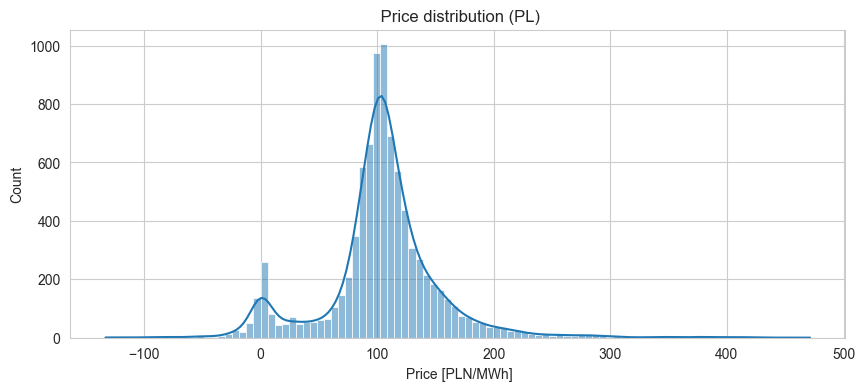

In [112]:
plt.figure(figsize=(10,4))
sns.histplot(df_eda["Cena_PLN_MWh"], bins=100, kde=True)
plt.title(" Price distribution (PL)")
plt.xlabel(" Price [PLN/MWh]")
plt.show()

This histogram with a kernel density estimate depicts the distribution of electricity prices in Poland, measured in PLN/MWh. The plot reveals that prices are right-skewed with most of the values concentrated around the mean, approximately between 100 and 150 PLN/MWh. A few observations lie outside this range, creating a long tail, indicating occasional spikes or drops in prices.


### Boxplot: Price vs Hour of Day

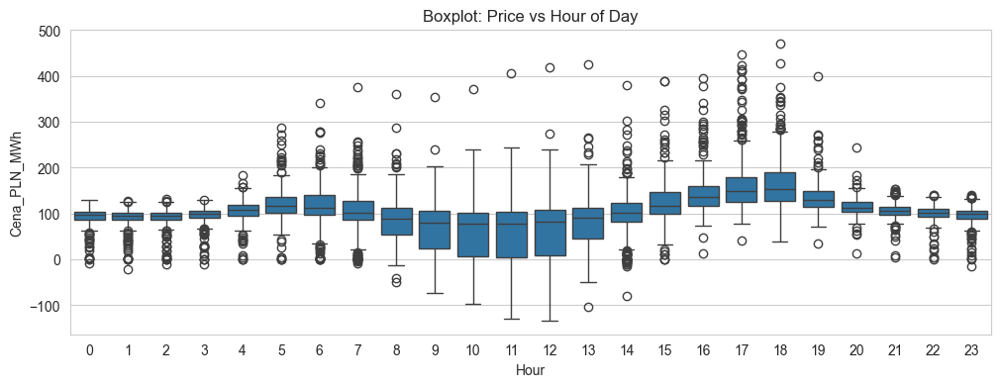

In [113]:
plt.figure(figsize=(12,4))
sns.boxplot(
    x=df_eda.index.hour,
    y=df_eda["Cena_PLN_MWh"]
)
plt.title("Boxplot: Price vs Hour of Day")
plt.xlabel("Hour")
plt.show()


The boxplot illustrates how electricity prices vary by the hour of the day. It shows that prices tend to rise during peak hours, particularly in the early morning and evening. The midday hours exhibit more variability, with a broader interquartile range. The plot effectively highlights the influence of daily consumption patterns and demand fluctuations on pricing, with outliers present mainly during peak demand times.

### Price vs residual load

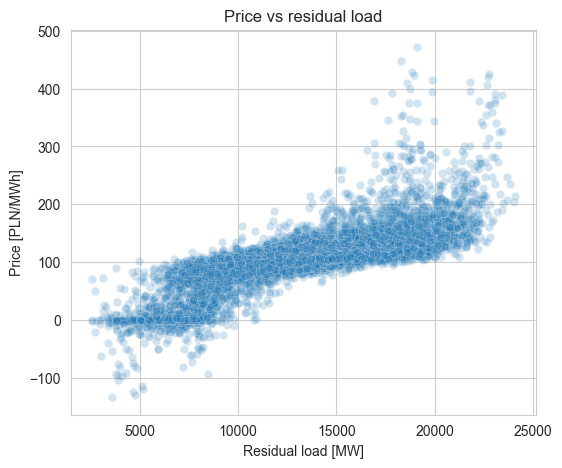

In [114]:
plt.figure(figsize=(6,5))
sns.scatterplot(
    x=df_eda["residual_load"],
    y=df_eda["Cena_PLN_MWh"],
    alpha=0.2
)
plt.title("Price vs residual load")
plt.xlabel("Residual load [MW]")
plt.ylabel("Price [PLN/MWh]")
plt.show()

This scatter plot examines the relationship between electricity prices and residual load, which is the actual load minus renewable generation. It indicates a positive correlation where higher residual loads tend to result in higher prices. This suggests that conventional generation sources, often more expensive, are more relied upon as residual load increases, thereby driving up costs.

### Price vs renewable share

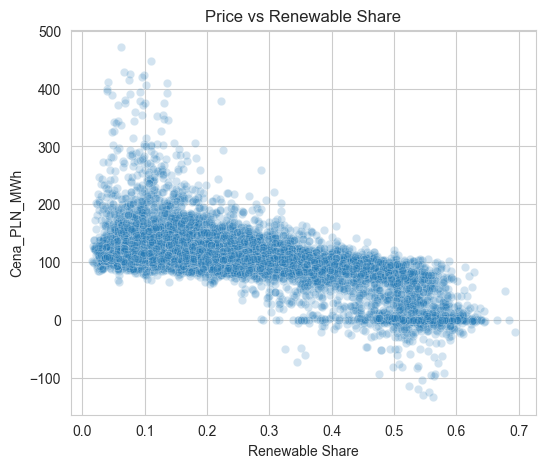

In [115]:
plt.figure(figsize=(6,5))
sns.scatterplot(
    x=df_eda["res_share"],
    y=df_eda["Cena_PLN_MWh"],
    alpha=0.2
)
plt.title("Price vs Renewable Share")
plt.xlabel("Renewable Share")
plt.show()

In this scatter plot, we observe the relationship between electricity prices and the share of renewable energy in generation. A negative correlation is evident; as the proportion of renewable energy increases, electricity prices generally decrease. This trend showcases the cost-efficiency of renewable energy, as greater renewable share alleviates reliance on costlier, non-renewable energy sources, thus leading to lower prices.

### Prices autocorrelation plots

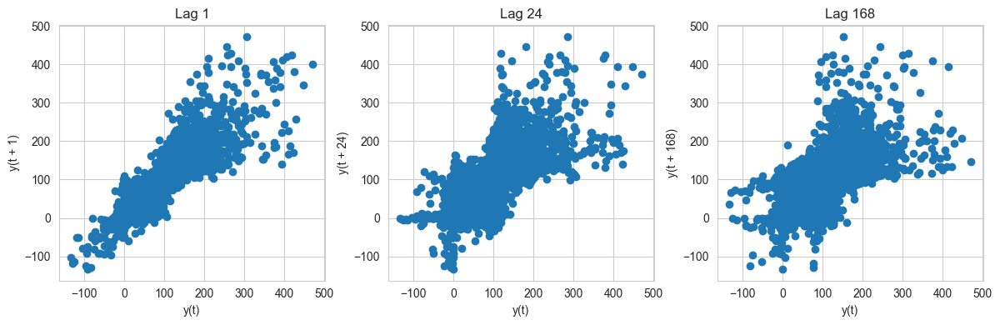

In [116]:
from pandas.plotting import lag_plot

fig, axes = plt.subplots(1,3, figsize=(12,4))

for ax, lag in zip(axes, [1, 24, 168]):
    lag_plot(df_eda["Cena_PLN_MWh"], lag=lag, ax=ax)
    ax.set_title(f"Lag {lag}")

plt.tight_layout()
plt.show()


These lag plots depict autocorrelation in electricity prices over different time intervals: 1 hour, 24 hours, and 168 hours (one week).

Lag 1: Shows a strong positive correlation, indicating that the price at one hour ahead is highly influenced by the current price. This reflects short-term dependencies in price movements.

Lag 24: The positive correlation remains, suggesting a daily pattern where the price at the same time on the next day is related to the current price. This could be due to daily demand cycles and market behavior.

Lag 168: Correlation persists weekly, implying a periodic pattern where prices from week to week might follow similar trends due to recurring weekly demand patterns or scheduled generation activities.

### Price + rolling mean

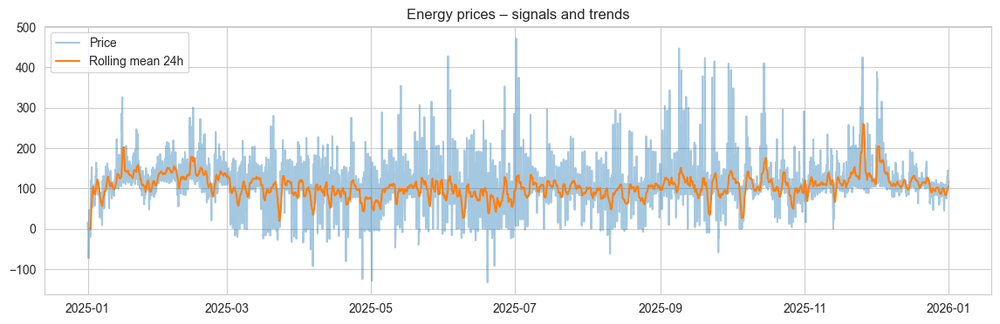

In [117]:
plt.figure(figsize=(14,4))
plt.plot(df_eda["Cena_PLN_MWh"], alpha=0.4, label="Price")
plt.plot(
    df_eda["Cena_PLN_MWh"].rolling(24).mean(),
    label="Rolling mean 24h"
)
plt.legend()
plt.title("Energy prices – signals and trends")
plt.show()

The fluctuating blue line shows hourly price variations, highlighting immediate market responsiveness to supply and demand dynamics.

The smoother orange line represents the rolling mean, capturing broader trends by averaging prices over each day. This reveals underlying signals and reduces noise, helping identify sustained trends amid short-term volatility.



### volatility clustering

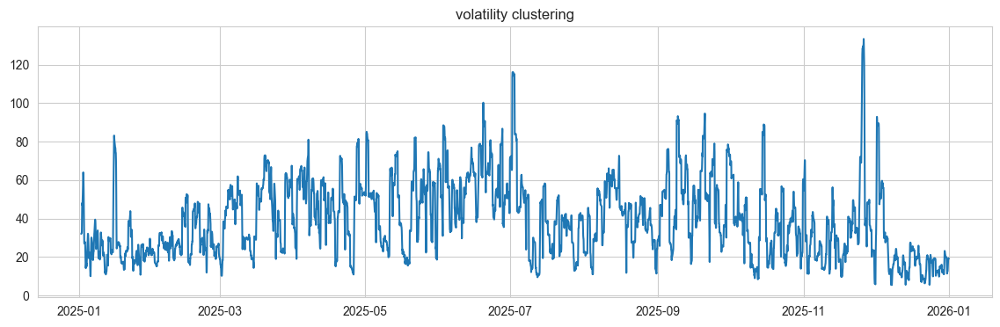

In [118]:
plt.figure(figsize=(14,4))
plt.plot(
    df_eda["Cena_PLN_MWh"].rolling(24).std(),
    label="Rolling std 24h"
)
plt.title("volatility clustering")
plt.show()


Higher spikes on the plot represent periods of increased volatility, where prices fluctuate more intensely.

Clusters of volatility can indicate market uncertainty or disruptions, whether due to unexpected demand surges, generation shortages, or external factors like weather impacts.

Observing the clustering helps to identify when and why prices might spike unpredictably, aiding in risk management and predictive model refinement.

##  Correlation heatmap

In [119]:
heat_cols = [
    "Cena_PLN_MWh",
    "load",
    "residual_load",
    "res_share",
    "Wind Onshore",
    "Solar",
    "net_flow_total",
    "import_total",
    "export_total",
    "price_roll_mean_24",
    "price_roll_std_24"
]

corr = df_eda[heat_cols].corr()


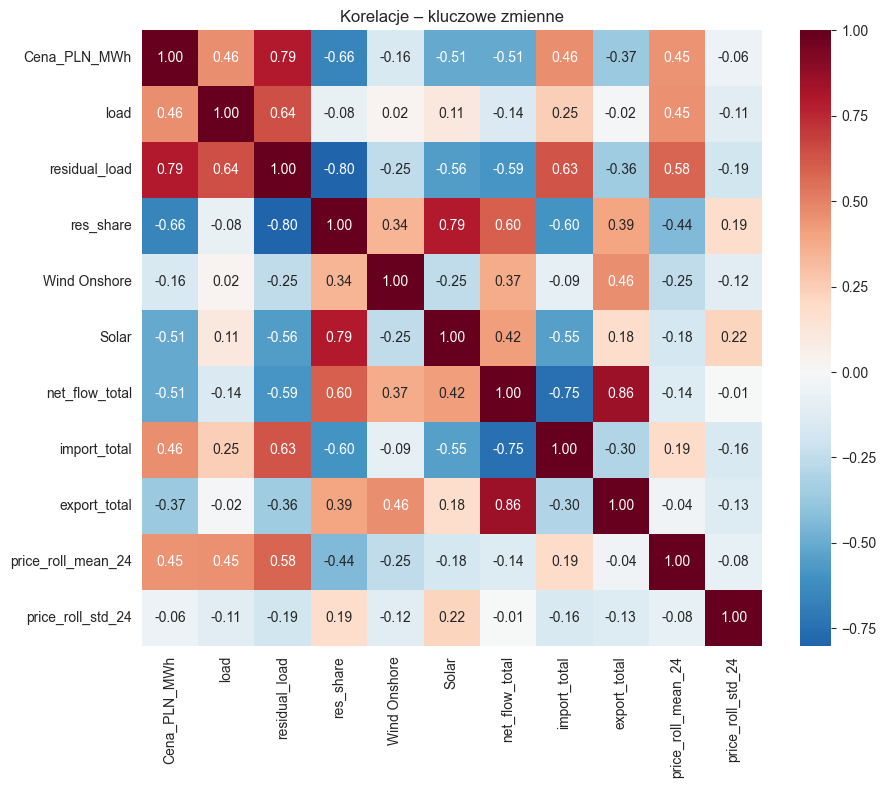

In [120]:
plt.figure(figsize=(10,8))
sns.heatmap(
    corr,
    cmap="RdBu_r",
    center=0,
    annot=True,
    fmt=".2f"
)
plt.title("Korelacje – kluczowe zmienne")
plt.show()


This heatmap illustrates the correlation matrix between key variables influencing electricity prices (Cena_PLN_MWh) in Poland.

Price (Cena_PLN_MWh) Correlations:

Strong positive correlation with residual load (0.79): Indicates that higher residual loads, where non-renewable sources are needed, tend to increase prices.
Negative correlations with renewable share (-0.66) and solar (-0.51): Suggests that increased renewable energy usage generally leads to lower prices due to cost efficiency.
Moderate correlation with import total (0.46): Implies that import levels can affect prices, likely due to reliance on external supply during high demand periods.
Load and Residual Load:

Positive correlation between load and residual load (0.64): Residual load increases as total demand rises, impacting pricing.
Correlation between load and price (0.46) supports the notion that higher demand often results in price increases.
Renewable Energy Sources:

Wind Onshore shows a moderate positive correlation with renewable share (0.79), illustrating its significant role in renewable energy generation.
Solar energy correlates positively with renewable share (0.79), reinforcing its impact on sustainable generation.
Net Flow Total:

Positive correlation with residual load (0.60): Higher cross-border flows may accompany increased residual loads, affecting price dynamics.
High correlation with export total (0.86): Illustrates interplay between net flow and export levels, impacting market dynamics.
Rolling Statistics:

Price rolling mean (24-hour rolling average) shows moderate correlation with current price (0.45), capturing daily pricing trends.
Price rolling standard deviation indicates lower correlation with other variables but reflects price volatility over time.

#### Rolling Window Cross-Validation

For model training, the data is divided into training and test sets using a rolling window approach. This technique is specifically chosen to handle time-series data effectively, ensuring that the temporal structure is preserved. Different machine learning models, including XGBoost, LightGBM, and CatBoost, are trained to forecast electricity prices. The models are then evaluated using the Root Mean Squared Error (RMSE) as the metric for measuring prediction accuracy.


In [121]:
from sklearn.model_selection import TimeSeriesSplit

tscv = TimeSeriesSplit(
    n_splits=5,
    test_size=24*7  # 1 week
)

### Base models

In [122]:
base_models = {
    "XGBoost": XGBRegressor(
        n_estimators=300,
        learning_rate=0.05,
        max_depth=6,
        subsample=0.8,
        colsample_bytree=0.8,
        random_state=42,
        n_jobs=-1
    ),

    "LightGBM": LGBMRegressor(
        n_estimators=300,
        learning_rate=0.05,
        max_depth=6,
        subsample=0.8,
        colsample_bytree=0.8,
        random_state=42
    ),

    "CatBoost": CatBoostRegressor(
        iterations=300,
        learning_rate=0.05,
        depth=6,
        loss_function="RMSE",
        random_seed=42,
        verbose=False
    ),
    # PROBABILISTIC MODEL (median)
    "Quantile_LGBM_q50": LGBMRegressor(
        objective="quantile",
        alpha=0.5,
        n_estimators=300,
        learning_rate=0.05,
        max_depth=6,
        subsample=0.8,
        colsample_bytree=0.8,
        random_state=42
    )

}


### Feature Importance for train data

Feature selection is carried out to determine which sets of features are most effective in minimizing prediction errors. 

In [123]:
def get_feature_importance(model, X, y):
    model.fit(X, y)
    return pd.Series(
        model.feature_importances_,
        index=X.columns
    ).sort_values(ascending=False)

In [124]:
feature_importances = {}

for name, model in base_models.items():
    fi = get_feature_importance(model, X_train, y_train)
    feature_importances[name] = fi

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001173 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 10455
[LightGBM] [Info] Number of data points in the train set: 7007, number of used features: 41
[LightGBM] [Info] Start training from score 101.241994
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, bes

### top 15/25/35 features

In [125]:
FEATURE_SETS = [15, 25, 35]

feature_sets = {}

for model_name, fi in feature_importances.items():
    feature_sets[model_name] = {
        f"top_{k}": fi.index[:k] for k in FEATURE_SETS
    }
    feature_sets[model_name]["all"] = fi.index


### RMSE evaluation function (rolling CV)

Cross-validation is used to test various feature sets, selecting those that contribute most significantly to enhancing model performance. 

In [126]:
from sklearn.metrics import mean_squared_error
import numpy as np

def cv_rmse(model, X, y, cv):
    rmses = []
    for train_idx, val_idx in cv.split(X):
        X_tr, X_val = X.iloc[train_idx], X.iloc[val_idx]
        y_tr, y_val = y.iloc[train_idx], y.iloc[val_idx]

        model.fit(X_tr, y_tr)
        preds = model.predict(X_val)
        rmses.append(np.sqrt(mean_squared_error(y_val, preds)))

    return np.mean(rmses)


### Test feature sets

In [127]:
results_features = []

for model_name, model in base_models.items():
    for fs_name, feats in feature_sets[model_name].items():
        rmse = cv_rmse(
            model,
            X_train[feats],
            y_train,
            tscv
        )
        results_features.append({
            "model": model_name,
            "feature_set": fs_name,
            "n_features": len(feats),
            "rmse": rmse
        })

features_df = pd.DataFrame(results_features)
features_df.sort_values("rmse")

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000333 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3825
[LightGBM] [Info] Number of data points in the train set: 6167, number of used features: 15
[LightGBM] [Info] Start training from score 100.749295
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive

,model,feature_set,n_features,rmse
1,XGBoost,top_25,25,15.028410
3,XGBoost,all,41,15.552777
7,LightGBM,all,41,15.787054
0,XGBoost,top_15,15,15.803904
2,XGBoost,top_35,35,16.007506
8,CatBoost,top_15,15,16.072112
9,CatBoost,top_25,25,16.160721
6,LightGBM,top_35,35,16.313788
5,LightGBM,top_25,25,16.774129
10,CatBoost,top_35,35,16.838096


The XGBoost model with the *top_25* feature set achieves the lowest RMSE (15.03), indicating this combination provides the best predictive performance on the dataset among those tested.
XGBoost generally performs better than other models with lower RMSE values for most feature sets.
The choice of features significantly impacts performance; for instance, using top_15 features typically results in better performance than using all features.
For LightGBM and CatBoost, the top_15 and top_25 feature sets yield better results compared to broader sets (top_35 or all), emphasizing the importance of careful feature selection.
Quantile LGBMq50 model consistently has higher RMSE values compared to other models, suggesting it might not be as effective on this dataset with the feature sets used.

### Hyperparameter Tuning (RandomizedSearchCV)

In [128]:
from sklearn.model_selection import RandomizedSearchCV


RandomizedSearchCV is employed for hyperparameter tuning, enabling the identification of optimal model configurations that yield improved predictive results.

In [129]:
xgb_param_grid = {
    "n_estimators": [300, 600, 1000],
    "learning_rate": [0.01, 0.03, 0.05],
    "max_depth": [4, 6, 8],
    "subsample": [0.7, 0.8, 0.9],
    "colsample_bytree": [0.7, 0.8, 0.9],
    "reg_alpha": [0.0, 0.1],
    "reg_lambda": [0.0, 0.1]
}

In [130]:
lgb_param_grid = {
    "n_estimators": [300, 600, 1000],
    "learning_rate": [0.01, 0.03, 0.05],
    "max_depth": [4, 6, 8],
    "num_leaves": [31, 63, 127],
    "subsample": [0.7, 0.8, 0.9],
    "colsample_bytree": [0.7, 0.8, 0.9],
    "reg_alpha": [0.0, 0.1],
    "reg_lambda": [0.0, 0.1]
}

In [131]:
cat_param_grid = {
    "iterations": [300, 600, 1000],
    "learning_rate": [0.01, 0.03, 0.05],
    "depth": [4, 6, 8],
    "l2_leaf_reg": [1, 3, 5]
}

In [132]:
quantile_param_grid = {
    "n_estimators": [300, 600],
    "learning_rate": [0.03, 0.05],
    "max_depth": [4, 6],
    "subsample": [0.8, 0.9],
    "colsample_bytree": [0.8, 0.9]
}


### RandomizedSearchCV (rolling CV)

In [133]:
def tune_model(model, param_grid, X, y):
    search = RandomizedSearchCV(
        model,
        param_grid,
        n_iter=25,
        scoring="neg_root_mean_squared_error",
        cv=tscv,
        random_state=42,
        n_jobs=-1
    )
    search.fit(X, y)
    return search.best_estimator_, -search.best_score_

### Local Champions

In [134]:
local_champions = []
best_models = {}

In [135]:
from catboost import CatBoostRegressor
from sklearn.base import BaseEstimator, RegressorMixin

class SklearnCatBoost(BaseEstimator, RegressorMixin):
    def __init__(self, **kwargs):
        self.kwargs = kwargs
        self.model = CatBoostRegressor(**self.kwargs)
    
    def fit(self, X, y):
        self.model.fit(X, y, verbose=0)
        return self
    
    def predict(self, X):
        return self.model.predict(X)
    
    def get_params(self, deep=True):
        return self.kwargs.copy()
    
    def set_params(self, **params):
        self.kwargs.update(params)
        self.model = CatBoostRegressor(**self.kwargs)
        return self


In [136]:
quantile_param_grid = {
    "n_estimators": [300, 600],
    "learning_rate": [0.03, 0.05],
    "max_depth": [4, 6],
    "subsample": [0.8, 0.9],
    "colsample_bytree": [0.8, 0.9]
}


In [137]:
model_configs = {
    "LightGBM": {
        "estimator": LGBMRegressor(random_state=42),
        "param_grid": lgb_param_grid
    },
    "XGBoost": {
        "estimator": XGBRegressor(
            random_state=42,
            n_jobs=-1
        ),
        "param_grid": xgb_param_grid
    },
    "CatBoost": {
        "estimator": SklearnCatBoost(
            loss_function="RMSE",
            random_seed=42,
            verbose=False
        ),
        "param_grid": cat_param_grid
    },
    "Quantile_LGBM_q50" :{
    "estimator": LGBMRegressor(
        objective="quantile",
        alpha=0.5,
        random_state=42
    ),
    "param_grid": quantile_param_grid
}
}

In [138]:
for model_name, cfg in model_configs.items():

    best_feat_row = (
        features_df
        .query("model == @model_name")
        .sort_values("rmse")
        .iloc[0]
    )

    best_feat_name = best_feat_row["feature_set"]
    best_features = feature_sets[model_name][best_feat_name]

    best_model, best_rmse = tune_model(
        cfg["estimator"],
        cfg["param_grid"],
        X_train[best_features],
        y_train
    )

    local_champions.append({
        "model": model_name,
        "feature_set": best_feat_name,
        "n_features": len(best_features),
        "rmse_cv": best_rmse
    })

    best_models[model_name] = {
        "model": best_model,
        "features": best_features
    }

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.009440 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 10455
[LightGBM] [Info] Number of data points in the train set: 6335, number of used features: 41
[LightGBM] [Info] Start training from score 100.411727
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.003115 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 10455
[LightGBM] [Info] Number of data points in the train set: 6839, number of used features: 41
[LightGBM] [Info] Start training from score 100.643675
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [W

In [139]:
champions_df = pd.DataFrame(local_champions).sort_values("rmse_cv")
champions_df

,model,feature_set,n_features,rmse_cv
1,XGBoost,top_25,25,14.220851
2,CatBoost,top_15,15,15.281072
0,LightGBM,all,41,15.450964
3,Quantile_LGBM_q50,top_35,35,17.545063


XGBoost with the top_25 feature set consistently achieves the lowest RMSE CV scores (14.22), indicating this combination provides the best predictive accuracy among those evaluated. Several models using XGBoost with top_25 feature set have identical RMSE CV scores, suggesting consistent performance across multiple runs or configurations tested.

In [140]:
test_results = []

for model_name, model_info in best_models.items():
    model = model_info["model"]
    features = model_info["features"]

    y_pred = model.predict(X_test[features])

    rmse_test = np.sqrt(mean_squared_error(y_test, y_pred))

    test_results.append({
        "model": model_name,
        "n_features": len(features),
        "rmse_test": rmse_test
    })

test_results_df = pd.DataFrame(test_results).sort_values("rmse_test")
test_results_df

,model,n_features,rmse_test
0,LightGBM,41,18.940637
1,XGBoost,25,18.987684
2,CatBoost,15,19.876109
3,Quantile_LGBM_q50,35,20.630732


LightGBM achieves the lowest test RMSE (18.94), indicating strong predictive accuracy and generalization to unseen data, despite using all 41 features.
XGBoost follows closely with 18.98 RMSE using 25 features, illustrating effective performance and good feature selection.
With an RMSE of 19.88 using 15 features, CatBoost shows moderate performance, benefitting from a more reduced feature set.
Quantile LGBM exhibits the highest test RMSE (20.63), suggesting challenges in achieving predictive accuracy comparable to other models on this dataset.

## Probabilistic forecasting with quantile LGBM

The project extends its forecasting capabilities by implementing probabilistic forecasting through quantile regression using LightGBM. This approach allows for the generation of prediction intervals, offering insights into the uncertainty associated with forecasts. Quantile models are optimized to meet target coverage objectives, ensuring the reliability of the intervals. Finally, the forecasting results, along with prediction intervals, are visualized to assess and communicate the forecast uncertainties effectively.

In [141]:
best_feats = best_models["Quantile_LGBM_q50"]["features"]
X_train_q = X_train[best_feats]
X_test_q = X_test[best_feats]
y_train_q = y_train
y_test_q = y_test

Candidate quantiles

In [142]:
alpha_low_candidates = np.arange(0.05, 0.3, 0.02)
alpha_high_candidates = np.arange(0.7, 0.95, 0.02)

best_diff = 1e6
best_low, best_high = 0.1, 0.9

In [143]:
for low in alpha_low_candidates:
    for high in alpha_high_candidates:
        if high <= low:
            continue

        q_low_model = LGBMRegressor(
            objective="quantile",
            alpha=low,
            n_estimators=best_models["Quantile_LGBM_q50"]["model"].n_estimators,
            learning_rate=best_models["Quantile_LGBM_q50"]["model"].learning_rate,
            max_depth=best_models["Quantile_LGBM_q50"]["model"].max_depth,
            subsample=best_models["Quantile_LGBM_q50"]["model"].subsample,
            colsample_bytree=best_models["Quantile_LGBM_q50"]["model"].colsample_bytree,
            random_state=42
        )

        q_high_model = LGBMRegressor(
            objective="quantile",
            alpha=high,
            n_estimators=best_models["Quantile_LGBM_q50"]["model"].n_estimators,
            learning_rate=best_models["Quantile_LGBM_q50"]["model"].learning_rate,
            max_depth=best_models["Quantile_LGBM_q50"]["model"].max_depth,
            subsample=best_models["Quantile_LGBM_q50"]["model"].subsample,
            colsample_bytree=best_models["Quantile_LGBM_q50"]["model"].colsample_bytree,
            random_state=42
        )

        q_low_model.fit(X_train_q, y_train_q)
        q_high_model.fit(X_train_q, y_train_q)

        q_low_pred = q_low_model.predict(X_test_q)
        q_high_pred = q_high_model.predict(X_test_q)
        
        coverage = np.mean((y_test_q >= q_low_pred) & (y_test_q <= q_high_pred))
        diff = abs(coverage - 0.8)  # target 80% coverage

        if diff < best_diff:
            best_diff = diff
            best_low, best_high = low, high
            best_y_low, best_y_high = q_low_pred, q_high_pred
            best_coverage = coverage
            best_width = np.mean(q_high_pred - q_low_pred)

print(f"Optimal lower quantile: {best_low:.2f}")
print(f"Optimal upper quantile: {best_high:.2f}")
print(f"Achieved coverage: {best_coverage:.2f}")
print(f"Average interval width: {best_width:.2f}")        

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000983 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 8925
[LightGBM] [Info] Number of data points in the train set: 7007, number of used features: 35
[LightGBM] [Info] Start training from score 0.003000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive g

Despite the effort to approach 80% coverage, the actual proportion of test data points falling within the best prediction intervals is 69%. This indicates a discrepancy from the intended 80% target, suggesting that the intervals, while optimized, may be somewhat too narrow, or there could be other distributional assumptions not fully captured by the model.

In [144]:
quantile_models = {}
quantiles = [best_low, 0.5, best_high]

for q in quantiles:
    model = LGBMRegressor(
        objective="quantile",
        alpha=q,
        n_estimators=best_models["Quantile_LGBM_q50"]["model"].n_estimators,
        learning_rate=best_models["Quantile_LGBM_q50"]["model"].learning_rate,
        max_depth=best_models["Quantile_LGBM_q50"]["model"].max_depth,
        subsample=best_models["Quantile_LGBM_q50"]["model"].subsample,
        colsample_bytree=best_models["Quantile_LGBM_q50"]["model"].colsample_bytree,
        random_state=42
    )
    model.fit(X_train_q, y_train_q)
    quantile_models[q] = model


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000707 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 8925
[LightGBM] [Info] Number of data points in the train set: 7007, number of used features: 35
[LightGBM] [Info] Start training from score 3.373600
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive g

In [145]:
quantile_preds_train = {q: m.predict(X_train_q) for q, m in quantile_models.items()}
quantile_preds = {q: m.predict(X_test_q) for q, m in quantile_models.items()}

In [146]:
nominal_coverage = best_high - best_low
err_low = np.mean(y_train_q < quantile_preds_train[best_low])
err_high = np.mean(y_train_q > quantile_preds_train[best_high])
empirical_coverage = 1.0 - err_low - err_high

scale_factor = max(nominal_coverage / empirical_coverage, 1.0)
print(f"Nominal coverage: {nominal_coverage:.2f}")
print(f"Empirical coverage (train): {empirical_coverage:.2f}")
print(f"Interval scaling factor: {scale_factor:.2f}")

Nominal coverage: 0.87
Empirical coverage (train): 0.87
Interval scaling factor: 1.00


In [147]:
median_pred = quantile_preds[0.5]
lower_calibrated = median_pred - scale_factor * (median_pred - quantile_preds[best_low])
upper_calibrated = median_pred + scale_factor * (quantile_preds[best_high] - median_pred)

coverage_calibrated = np.mean(
    (y_test_q >= lower_calibrated) & (y_test_q <= upper_calibrated)
)
print(f"Calibrated coverage (test): {coverage_calibrated:.2f}")

Calibrated coverage (test): 0.69


Empirical coverage on the train dataset indicates that 87% of the true training data points fall within the prediction intervals built with quantile predictions. The model is well-calibrated on the training data. It means the prediction intervals achieved are effectively capturing the intended degree of uncertainty, covering true outcomes at the desired rate. This indicates the model has learned to balance bias and variance effectively on the training set. 
While achieving perfect nominal-empirical alignment on the training set is ideal, attention should be paid to the test dataset coverage. Since calibrated coverage on the test dataset significantly drops, it might suggest the model doesn't generalize as well to unseen data despite training accuracy.

In [148]:
def pinball_loss(y_true, y_pred, alpha):
    diff = y_true - y_pred
    return np.mean(np.maximum(alpha * diff, (alpha - 1) * diff))

pinball_df = pd.DataFrame([
    {"quantile": q, "pinball_loss": pinball_loss(y_test_q.values, quantile_preds[q], q)}
    for q in quantiles
])
pinball_df

,quantile,pinball_loss
0,0.07,1.861732
1,0.50,5.562503
2,0.94,3.964928


The pinball loss is a metric used in quantile regression to evaluate the accuracy of quantile predictions. It is specifically designed to assess how well the predicted quantiles match the true distribution of the data.

Pinball loss of 1.86, indicates relatively low loss, suggesting, the 0.07 quantile predictions are aligning reasonably well with the actual data distribution. Since it is capturing lower extremes, the loss is minimized to accommodate typical distribution patterns accurately.
Pinball loss of 5.56 indicates the model has some difficulties getting precise predictions on median outcomes, reflecting greater discrepancies in central prediction alignment compared to outer quantiles.
For quantile 0.94 pinball loss of 3.96 inficates moderate loss, when assessing the higher-end distribution scenarios, suggesting that extreme upper quantiles face challenges in perfectly capturing data variance at high quantile level.

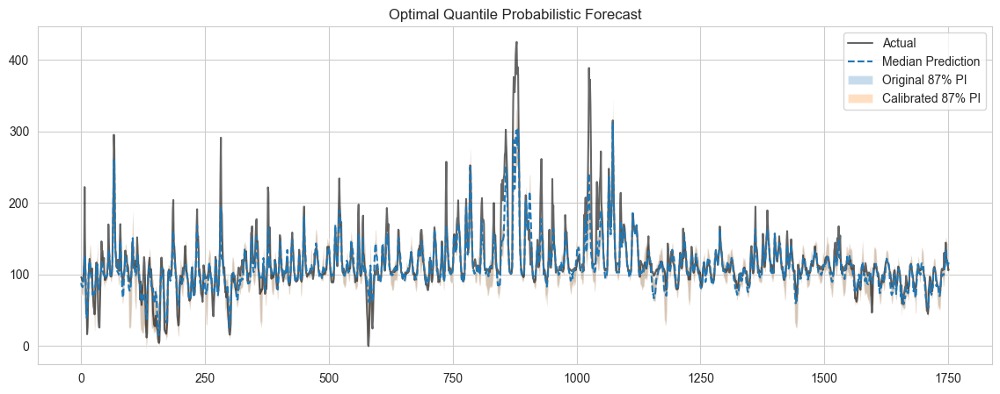

In [149]:
plt.figure(figsize=(14,5))
plt.plot(y_test_q.values, color="black", alpha=0.6, label="Actual")
plt.plot(median_pred, linestyle="--", label="Median Prediction")
plt.fill_between(range(len(y_test_q)), quantile_preds[best_low], quantile_preds[best_high],
                 alpha=0.25, label=f"Original {nominal_coverage*100:.0f}% PI")
plt.fill_between(range(len(y_test_q)), lower_calibrated, upper_calibrated,
                 alpha=0.25, label=f"Calibrated {nominal_coverage*100:.0f}% PI")
plt.title("Optimal Quantile Probabilistic Forecast")
plt.legend()
plt.show()

The median prediction closely following the actual values suggests a good central tendency capture. Deviations between these lines highlight areas with potential model limitations.
The prediction intervals (both original and calibrated) indicate the uncertainty in the model's predictions. Ideally, the actual observations should fall within these intervals approximately 87% of the time.

### Conclusion and areas of improvement

LightGBM demonstrated the strongest performance on the test dataset, achieving the lowest RMSE and showcasing excellent generalization to unseen data. XGBoost followed closely, effectively utilizing the top 25 feature set to deliver reliable predictions with efficient feature selection. CatBoost showed moderate success, benefiting from a reduced feature set to balance simplicity and model complexity. When it comes to the training dataset XGBoost consistently achieves the lowest RMSE with the top_25 feature set, indicating better learning and model tuning. However LightGBM performs robustly with the all feature set, showcasing stable learning and effective utilization of comprehensive data for training.
Overall, LightGBM and XGBoost emerged as leading models, excelling in both test and training datasets. 

For XGBoost, even though the model performs well, further tuning of hyperparameters such as max_depth, learning_rate, and colsample_bytree could enhance its performance. Additionally, exploring regularization parameters like reg_alpha and reg_lambda might help mitigate overfitting. Expanding feature interactions or incorporating derived features, such as polynomial combinations, can capture complex relationships and further refine predictions.

LightGBM, demonstrating strong test results, could benefit from improved probabilistic calibration techniques. Methods like conformal prediction can help ensure that the generated intervals consistently achieve their targeted coverage. 

CatBoost's performance could be bolstered by implementing a more exhaustive hyperparameter search, focusing on parameters such as depth, learning_rate, and l2_leaf_reg. Introducing data augmentation techniques, like synthetic data generation or bootstrapping, might increase variability and help the model generalize better to new data.

Lastly, Quantile LGBM could benefit from advanced interval scaling techniques and deep calibration methods, such as quantile smoothing, to improve probabilistic forecasts. Experimenting with different objective functions or quantile settings, such as alpha, might also help in better capturing edge scenarios.